In [1]:
import os
import numpy as np
import scipy.stats
import seaborn as sns
import matplotlib.pyplot as plt

import cubnm
import cubnm_paper

# set plots font and dpi
# Note: the font is not included in the repository
import matplotlib.font_manager
font_path = os.path.join(cubnm_paper.config.DATA_DIR, 'assets', 'Optima.ttc')
matplotlib.font_manager.fontManager.addfont(font_path)
font = matplotlib.font_manager.FontProperties(fname=font_path, size=12)
plt.rcParams.update({
    "font.family": font.get_name(),
    "figure.dpi": 600
})

Load grid:

In [2]:
grid = cubnm_paper.data.load_grid(grid_shape=22)

Optimal point:

In [5]:
grid.opt.round(3)

G               1.429
w_p             0.095
J_N             0.381
+fc_corr        0.298
-fcd_ks        -0.152
+gof            0.146
-fic_penalty   -0.028
cost           -0.119
Name: 1490, dtype: float64

# A. Grids of cost and its components

/tmp/ipykernel_12649/134071307.py:3: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), fontsize=8)
/tmp/ipykernel_12649/134071307.py:6: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_zticklabels(ax.get_zticklabels(), fontsize=8)
/tmp/ipykernel_12649/134071307.py:8: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


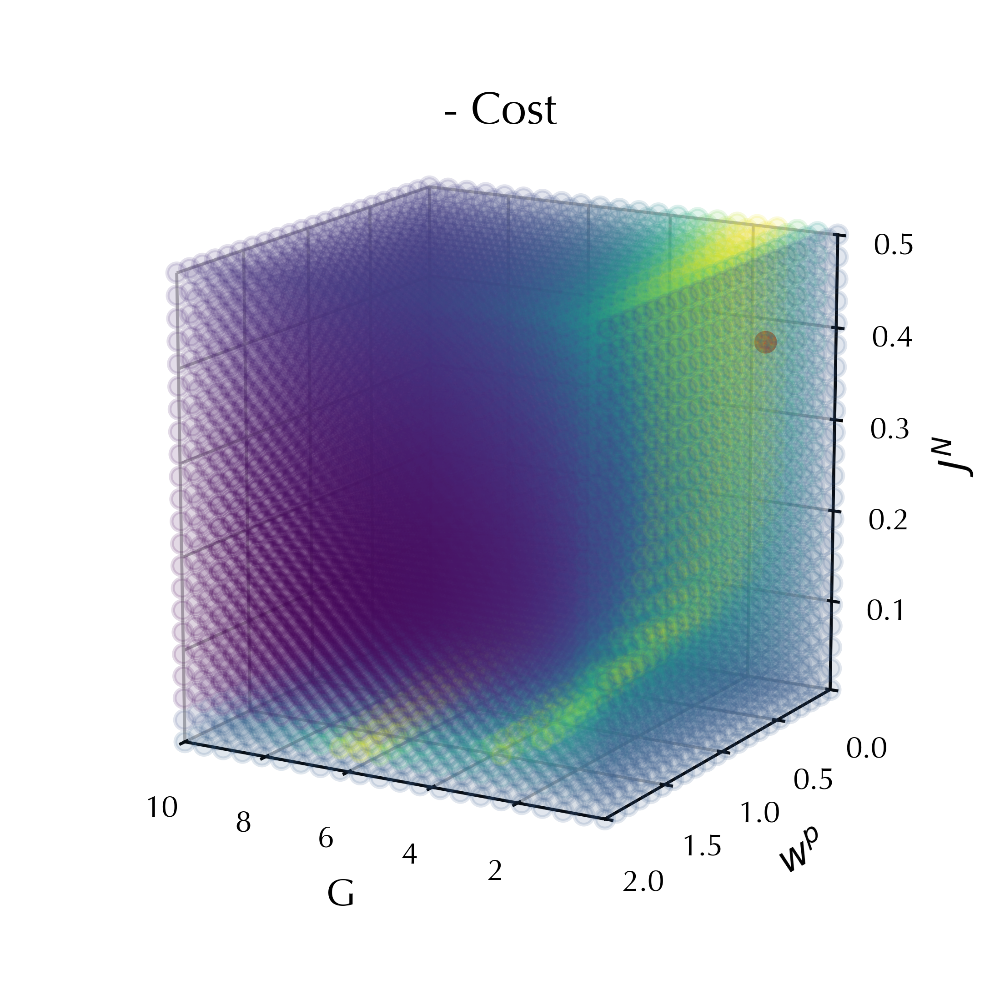

In [6]:
fig, ax = plt.subplots(figsize=(4.5,4.5), subplot_kw={'projection': '3d'})
grid.plot_space('-cost', opt=True, config=dict(size=25, alpha=0.15, azim=120, opt_edgecolor='red', opt_facecolor='red'), ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), fontsize=8)
ax.set_yticks(ax.get_yticks()[::2]) # remove every other tick for w_p (to make the ticklabels less crowded)
ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
ax.set_zticklabels(ax.get_zticklabels(), fontsize=8)
ax.set_title(ax.get_title(), y=0.95)
fig.tight_layout()
fig.savefig('-cost.png', transparent=True)

/tmp/ipykernel_12649/2536847587.py:5: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), fontsize=8)
/tmp/ipykernel_12649/2536847587.py:6: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
/tmp/ipykernel_12649/2536847587.py:7: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_zticklabels(ax.get_zticklabels(), fontsize=8)
/tmp/ipykernel_12649/2536847587.py:5: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), fontsize=8)
/tmp/ipykernel_12649/2536847587.py:6: UserWarning: set_ticklabels() should only be used with a fixed number of ticks

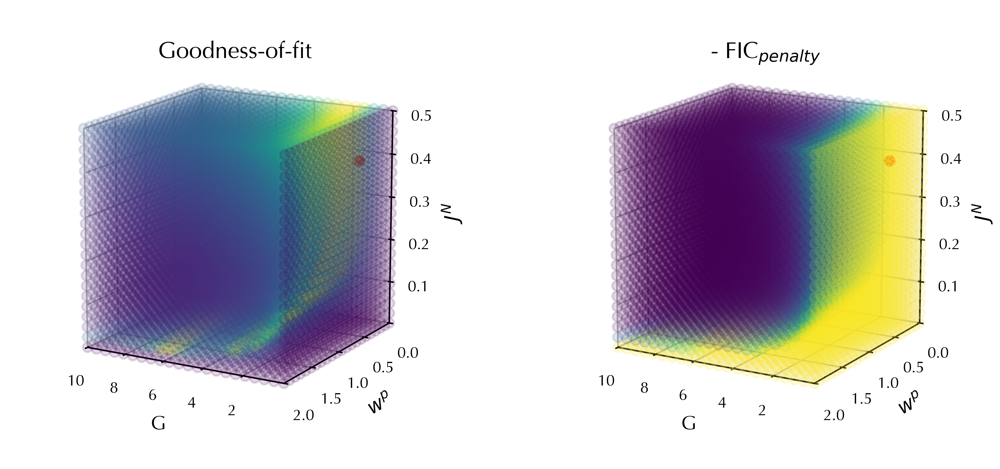

In [7]:
fig, axes = plt.subplots(1, 2, figsize=(9, 4.5), subplot_kw={'projection': '3d'})
for i, var in enumerate(['+gof', '-fic_penalty']):
    ax = axes[i]
    grid.plot_space(var, opt=True, config=dict(size=25, alpha=0.15, azim=120, opt_edgecolor='red', opt_facecolor='red'), ax=ax)
    ax.set_xticklabels(ax.get_xticklabels(), fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.set_zticklabels(ax.get_zticklabels(), fontsize=8)
    ax.set_title(ax.get_title(), y=0.95)
axes[1].set_title('- FIC$_{penalty}$', y=0.95)
fig.tight_layout()
fig.savefig('gof_fic_penalty.png', transparent=True)

/tmp/ipykernel_12649/1928343304.py:5: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), fontsize=8)
/tmp/ipykernel_12649/1928343304.py:6: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
/tmp/ipykernel_12649/1928343304.py:7: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_zticklabels(ax.get_zticklabels(), fontsize=8)
/tmp/ipykernel_12649/1928343304.py:5: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), fontsize=8)
/tmp/ipykernel_12649/1928343304.py:6: UserWarning: set_ticklabels() should only be used with a fixed number of ticks

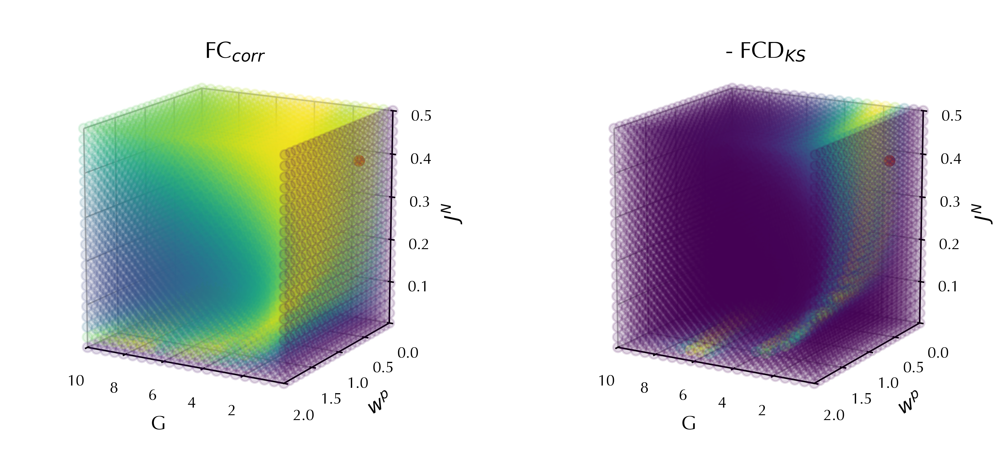

In [8]:
fig, axes = plt.subplots(1, 2, figsize=(9, 4.5), subplot_kw={'projection': '3d'})
for i, var in enumerate(['+fc_corr', '-fcd_ks']):
    ax = axes[i]
    grid.plot_space(var, opt=True, config=dict(size=25, alpha=0.15, azim=120, opt_edgecolor='red', opt_facecolor='red'), ax=ax)
    ax.set_xticklabels(ax.get_xticklabels(), fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.set_zticklabels(ax.get_zticklabels(), fontsize=8)
    ax.set_title(ax.get_title(), y=0.95)
fig.tight_layout()
fig.savefig('fc_corr_fcd_ks.png', transparent=True)

Low-High colorbar:

/tmp/ipykernel_32474/3465512564.py:8: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap('viridis')
/tmp/ipykernel_32474/3465512564.py:21: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


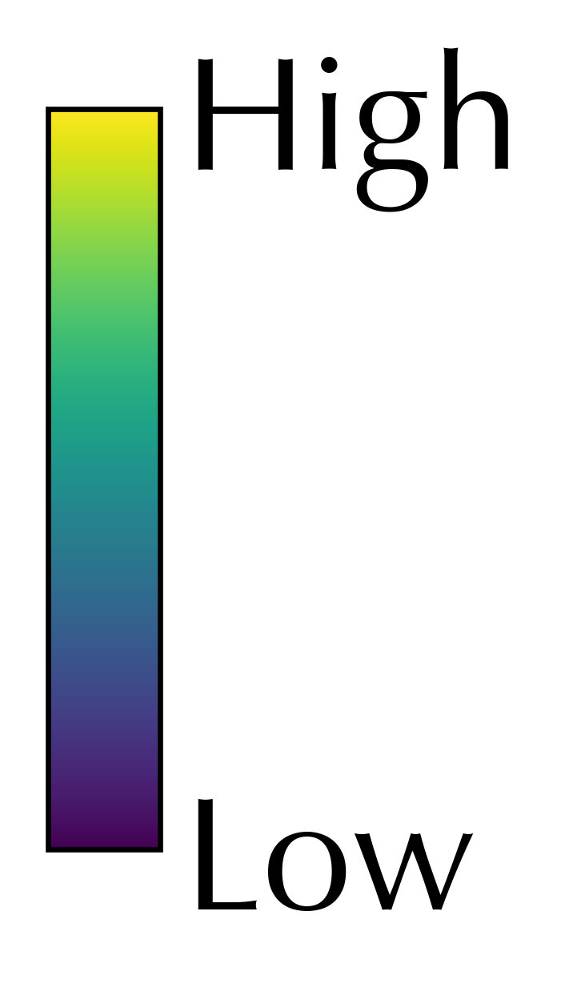

In [67]:
# AI-generated code
import matplotlib.cm as cm
import matplotlib.colors as mcolors

fig, ax = plt.subplots(figsize=(0.3, 2.0))

# create a colormap normalization
norm = mcolors.Normalize(vmin=0, vmax=1)
cmap = cm.get_cmap('viridis')
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])

# add colorbar
cbar = fig.colorbar(sm, cax=ax)

# set only "Low" and "High" as ticks
# hide tick lines
cbar.set_ticks([0, 1])
cbar.set_ticklabels(['Low', 'High'], fontsize=24)
cbar.ax.tick_params(size=0)

fig.tight_layout()

# B. Grids of state variables

/tmp/ipykernel_12649/3006072349.py:5: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), fontsize=8)
/tmp/ipykernel_12649/3006072349.py:6: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
/tmp/ipykernel_12649/3006072349.py:7: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_zticklabels(ax.get_zticklabels(), fontsize=8)
/tmp/ipykernel_12649/3006072349.py:5: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), fontsize=8)
/tmp/ipykernel_12649/3006072349.py:6: UserWarning: set_ticklabels() should only be used with a fixed number of ticks

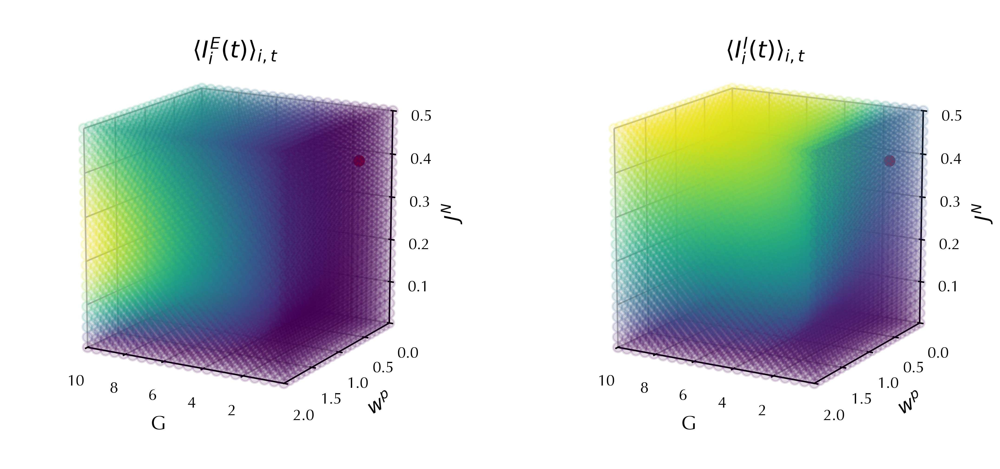

In [9]:
fig, axes = plt.subplots(1, 2, figsize=(9, 4.5), subplot_kw={'projection': '3d'})
for i, var in enumerate(['I_E', 'I_I']):
    ax = axes[i]
    grid.plot_space(var, opt=True, config=dict(size=25, alpha=0.15, azim=120, opt_edgecolor='red', opt_facecolor='red'), ax=ax)
    ax.set_xticklabels(ax.get_xticklabels(), fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.set_zticklabels(ax.get_zticklabels(), fontsize=8)
    state_var, neuron = var.split('_')
    title = r'$\langle '+state_var+r'^'+neuron+r'_i(t) \rangle_{i,t}$'
    ax.set_title(title, y=0.95)
fig.tight_layout()
fig.savefig('I.png', transparent=True)

/tmp/ipykernel_12649/2026786786.py:5: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), fontsize=8)
/tmp/ipykernel_12649/2026786786.py:6: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
/tmp/ipykernel_12649/2026786786.py:7: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_zticklabels(ax.get_zticklabels(), fontsize=8)
/tmp/ipykernel_12649/2026786786.py:5: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), fontsize=8)
/tmp/ipykernel_12649/2026786786.py:6: UserWarning: set_ticklabels() should only be used with a fixed number of ticks

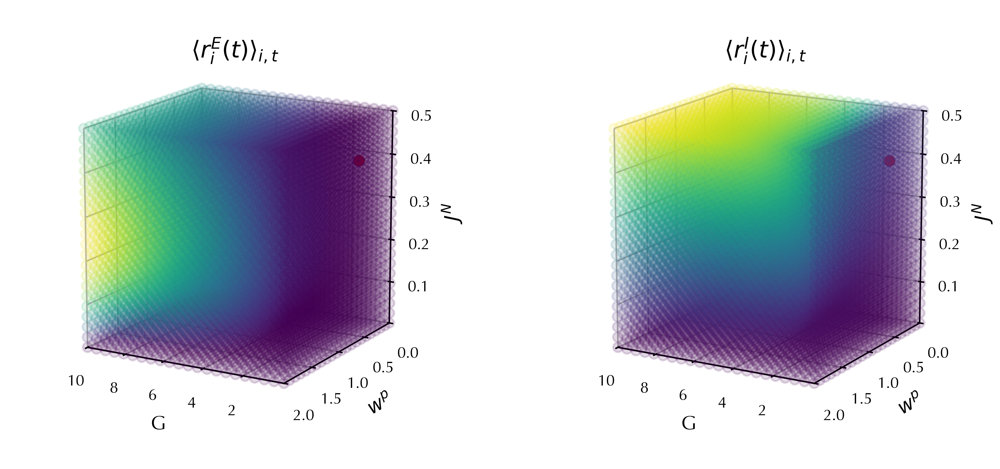

In [12]:
fig, axes = plt.subplots(1, 2, figsize=(9, 4.5), subplot_kw={'projection': '3d'})
for i, var in enumerate(['r_E', 'r_I']):
    ax = axes[i]
    grid.plot_space(var, opt=True, config=dict(size=25, alpha=0.15, azim=120, opt_edgecolor='red', opt_facecolor='red'), ax=ax)
    ax.set_xticklabels(ax.get_xticklabels(), fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.set_zticklabels(ax.get_zticklabels(), fontsize=8)
    state_var, neuron = var.split('_')
    title = r'$\langle '+state_var+r'^'+neuron+r'_i(t) \rangle_{i,t}$'
    ax.set_title(title, y=0.95)
fig.tight_layout()
fig.savefig('r.png', transparent=True)

/tmp/ipykernel_12649/246387336.py:5: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), fontsize=8)
/tmp/ipykernel_12649/246387336.py:6: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
/tmp/ipykernel_12649/246387336.py:7: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_zticklabels(ax.get_zticklabels(), fontsize=8)
/tmp/ipykernel_12649/246387336.py:5: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), fontsize=8)
/tmp/ipykernel_12649/246387336.py:6: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e

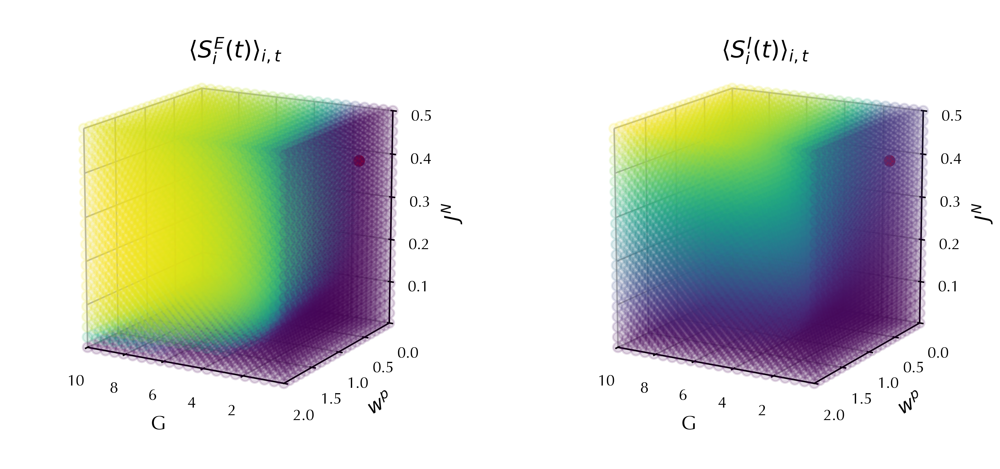

In [13]:
fig, axes = plt.subplots(1, 2, figsize=(9, 4.5), subplot_kw={'projection': '3d'})
for i, var in enumerate(['S_E', 'S_I']):
    ax = axes[i]
    grid.plot_space(var, opt=True, config=dict(size=25, alpha=0.15, azim=120, opt_edgecolor='red', opt_facecolor='red'), ax=ax)
    ax.set_xticklabels(ax.get_xticklabels(), fontsize=8)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=8)
    ax.set_zticklabels(ax.get_zticklabels(), fontsize=8)
    state_var, neuron = var.split('_')
    title = r'$\langle '+state_var+r'^'+neuron+r'_i(t) \rangle_{i,t}$'
    ax.set_title(title, y=0.95)
fig.tight_layout()
fig.savefig('S.png', transparent=True)

# Text. Test fit

Create a `rWWSimGroup` using test dataset's SC, apply optimal parameters (obtained from the train dataset), and assess its score against empirical FC and FCD of test dataset:

In [8]:
test_data = dict(
    sc = cubnm.datasets.load_sc('strength', sub='group-test303'),
    emp_fc_tril = cubnm.datasets.load_fc(sub='group-test303', exc_interhemispheric=True),
    emp_fcd_tril = cubnm.datasets.load_fcd(sub='group-test303', exc_interhemispheric=True)
)

sim_options = copy.deepcopy(cubnm_paper.config.HCP_SIM_OPTIONS)

test_sg = cubnm.sim.rWWSimGroup(
    sc = test_data['sc'],
    **sim_options
)

# set N and parameters
test_sg.N = 1
test_sg.param_lists['G'] = grid.opt_sim_data['G'].copy()
test_sg.param_lists['w_p'] = grid.opt_sim_data['w_p'].copy()
test_sg.param_lists['J_N'] = grid.opt_sim_data['J_N'].copy()
test_sg._set_default_params(missing=True) # default parameters (sigma)
# run and score simulation
test_sg.run()
score = test_sg.score(
    emp_fc_tril=test_data['emp_fc_tril'],
    emp_fcd_tril=test_data['emp_fcd_tril']
)
# add cost
score['cost'] = -(score['+gof'] + score['-fic_penalty'])
score.round(3)

Initializing CPU session...
Freeing CPU memory (rWW)
Precalculating 60000000 noise elements...
noise will be repeated 30 times (nodes [rows] and timepoints [columns] will be shuffled in each repeat)
took 2.814950 s
Running 1 simulations...
nodes: 100
N_SIMS: 1
N_SCs: 1
BOLD_TR: 720
states_sampling: 720
time_steps: 900000
do_delay: 0
sim_seed: 0
exc_interhemispheric: 1
verbose: 1
progress_interval: 500
bold_remove_s: 30
drop_edges: 1
ext_out: 1
do_fc: 1
do_fcd: 1
states_ts: 0
noise_time_steps: 30000
Thread 0 (of 12) is executing particle 0 [08:34:35]
Simulations completed
Simulations and calculation of FC and FCD took 118.527128 s


,+fc_corr,-fcd_ks,+gof,-fic_penalty,cost
0,0.297,-0.152,0.146,-0.028,-0.118
